# HHA550_Stroke Prediction Dataset

## Healtcare-dataset-Diabetes-Data

## PreReq
#import/install everything need

In [93]:
#Commands to install some of the libraries in-case if they are not installed
#Any other library that needs to be installed just use: !pip install <library name>
!pip install seaborn
!pip install missingno
!pip install xgboost
!pip install catboost
!pip install regex
!pip install sklearn
!pip install pandas
!pip install numpy
!pip install imblearn
!pip install lightgbm
!pip install -U scikit-learn
!pip install nbformat==4.2.0
!pip install statsmodels


In [2]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
from scipy import stats
import seaborn as sns   #data visualizations 
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction
from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching
import nbformat 
# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split

## Only use when needed

In [3]:
from sklearn.model_selection import KFold,cross_val_score, RepeatedStratifiedKFold,StratifiedKFold
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder,StandardScaler,PowerTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer,SimpleImputer
from sklearn.compose import make_column_transformer
from imblearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.impute import SimpleImputer
from sklearn.dummy import DummyClassifier
from imblearn.over_sampling import SMOTE
from sklearn.neighbors import KNeighborsClassifier
import plotly 
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")
# problem with these imports
# from sklearn.metrics import confusion_matrix, accuracy_score, balanced_accuracy_score,\
#                             precision_score, recall_score, roc_auc_score,\
#                             plot_confusion_matrix, classification_report, plot_roc_curve, f1_score

In [7]:
#upload the csv and declare its name to = the csv
#for this course we will name the dataframe 'stroke', but you can change it to df or anything else you want.
#Find the file path to the .csv
#Then use code below to read .csv
diabetes = pd.read_csv('/Users/marialozano/Documents/GitHub/CleanDiabetes_Dataset/original/clean_data.csv')

#### Looking at the data

In [8]:
#make sure csv has been assigned to declared name and can be read
diabetes.head(10)
# this command will give you the first 5 lines of the csv (0,1,2,3,4)
# we are looking at the first 10

,encounter_id,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
0,2278392,8222157,1,1,1,999,6,25,1,1,...,0,0,0,0,0,0,0,0,0,0
1,149190,55629189,1,1,2,999,1,1,7,3,...,0,3,0,0,0,0,0,1,1,1
2,64410,86047875,2,1,3,999,1,1,7,2,...,0,0,0,0,0,0,0,0,1,0
3,500364,82442376,1,2,4,999,1,1,7,2,...,0,3,0,0,0,0,0,1,1,0
4,16680,42519267,1,2,5,999,1,1,7,1,...,0,2,0,0,0,0,0,1,1,0
5,35754,82637451,1,2,6,999,2,1,2,3,...,0,2,0,0,0,0,0,0,1,1
6,55842,84259809,1,2,7,999,3,1,2,4,...,0,2,0,0,0,0,0,1,1,0
7,63768,114882984,1,2,8,999,1,1,7,5,...,0,0,0,0,0,0,0,0,1,1
8,12522,48330783,1,1,9,999,2,1,4,13,...,0,2,0,0,0,0,0,1,1,0
9,15738,63555939,1,1,10,999,3,3,4,12,...,0,2,0,0,0,0,0,1,1,0


In [9]:
#Some more intial looks at the data to make sure proper cleanning has been done
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 49 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   encounter_id              101766 non-null  int64  
 1   patient_nbr               101766 non-null  int64  
 2   race                      101766 non-null  int64  
 3   gender                    101766 non-null  object 
 4   age                       101766 non-null  int64  
 5   weight                    101766 non-null  object 
 6   admission_type_id         101766 non-null  int64  
 7   discharge_disposition_id  101766 non-null  int64  
 8   admission_source_id       101766 non-null  int64  
 9   time_in_hospital          101766 non-null  int64  
 10  medical_specialty         101309 non-null  float64
 11  num_lab_procedures        101766 non-null  int64  
 12  num_procedures            101766 non-null  int64  
 13  num_medications           101766 non-null  i

# Exploring and Understanding the Data


### Initial Insights
* come back to finsh

# What are the current problems we have that need to be solved?
* come back to later 

## Insights into our target variable
* One of the first steps of exploratory data analysis should always be to look at what the values of y look like.

In [10]:
y = diabetes['readmitted']
print(f'Percentage of patient had a readmission: % {round(y.value_counts(normalize=True)[2]*100,2)} --> ({y.value_counts()[2]} patient)\nPercentage of patient did not have a readmission: % {round(y.value_counts(normalize=True)[1]*100,2)} --> ({y.value_counts()[1]} patient)')

Percentage of patient had a readmission: % 11.16 --> (11357 patient)
Percentage of patient did not have a readmission: % 34.93 --> (35545 patient)


### So what does that all mean?
Our data looks consistent to analyze with all values being filled in each column

### Visualize Diabetes reamissions Rate

In [11]:
fig = px.histogram(diabetes, x="readmitted", title='Readmitted', width=400, height=400)
fig.show()

## Decide on Metrics

* There is a skew towards the left

In [12]:
diabetes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 49 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   encounter_id              101766 non-null  int64  
 1   patient_nbr               101766 non-null  int64  
 2   race                      101766 non-null  int64  
 3   gender                    101766 non-null  object 
 4   age                       101766 non-null  int64  
 5   weight                    101766 non-null  object 
 6   admission_type_id         101766 non-null  int64  
 7   discharge_disposition_id  101766 non-null  int64  
 8   admission_source_id       101766 non-null  int64  
 9   time_in_hospital          101766 non-null  int64  
 10  medical_specialty         101309 non-null  float64
 11  num_lab_procedures        101766 non-null  int64  
 12  num_procedures            101766 non-null  int64  
 13  num_medications           101766 non-null  i

In [13]:
def missing (diabetes):
    missing_number = diabetes.isnull().sum().sort_values(ascending=False)
    missing_percent = (diabetes.isnull().sum()/diabetes.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(diabetes)

,Missing_Number,Missing_Percent
medical_specialty,457,0.004491
encounter_id,0,0.000000
tolazamide,0,0.000000
glimepiride,0,0.000000
acetohexamide,0,0.000000
glipizide,0,0.000000
glyburide,0,0.000000
tolbutamide,0,0.000000
pioglitazone,0,0.000000
rosiglitazone,0,0.000000


# we can see that data has same count of values in each field with appropriate data types 
* check clean.py to see edits made or data dictonary to see further explanation

# Numerical Features
* Look at the data elements (columns) using `diabetes.head()`
* Look at the Dtype (data type) using `diabetes.info()`

In [14]:
categorical = ['gender', 'race', 'admission_type_id', 'admission_source_id',
'medical_specialty', 'discharge_disposition_id', 'medical_specialty', 'diag_1', 'diag_2', 'diag_3']

numerical = ['age','time_in_hospital', 'num_lab_procedures', 'num_procedures',
             'num_medications', 'number_outpatient', 'number_emergency', 'number_diagnoses', 'number_inpatient',]

In [15]:
diabetes[numerical].describe()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,7.096702,4.395987,43.095641,1.339730,16.021844,0.369357,0.197836,7.422607,0.635566
std,1.594084,2.985108,19.674362,1.705807,8.127566,1.267265,0.930472,1.933600,1.262863
min,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
25%,6.000000,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,6.000000,0.000000
50%,7.000000,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,8.000000,0.000000
75%,8.000000,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,9.000000,1.000000
max,10.000000,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,16.000000,21.000000


In [16]:
diabetes[numerical].skew()

age                   -0.630539
time_in_hospital       1.133999
num_lab_procedures    -0.236544
num_procedures         1.316415
num_medications        1.326672
number_outpatient      8.832959
number_emergency      22.855582
number_diagnoses      -0.876746
number_inpatient       3.614139
dtype: float64

### We can see skewness in both left and right for numerical data, as seen above (16,17)
* Neagtive skew values mean skewness to the right 
* Postive skew values mean skewness to the left 

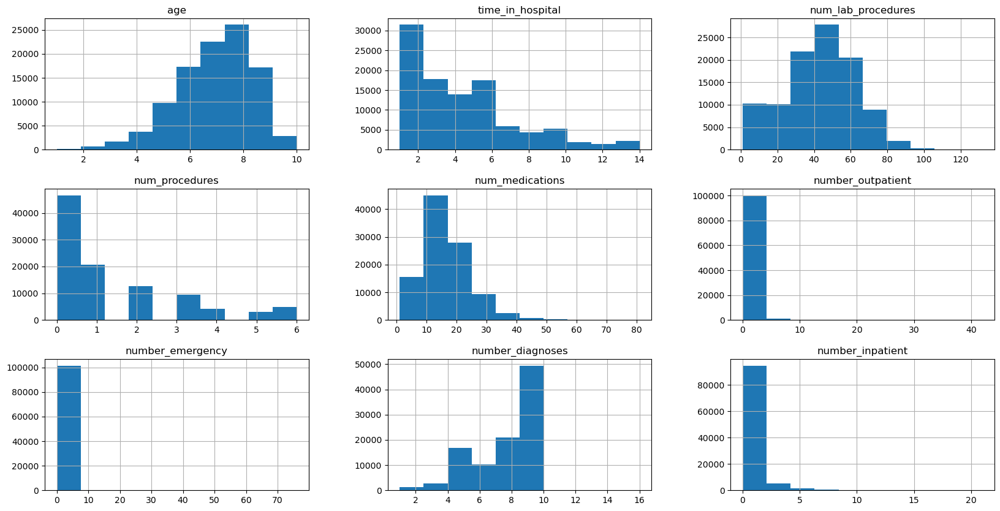

In [17]:
diabetes[numerical].hist(figsize=(20,10));

# Categorical Feautres
* gender
* race
* admission_type_id
* admission_source_id
* medical_specialty
* discharge_disposition_id
* medical_specialty
* diag_1
* diag_2
* diag_3
 

### Gender

In [18]:
print (f'{round(diabetes["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="gender", title='Gender', width=500, height=500)
fig.show()

1                  27.89
1                  25.87
2                  23.81
2                  22.43
Unknown/Invalid     0.00
Name: gender, dtype: float64


In [41]:
print (f'{round(diabetes["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="race", title='Race', width=500, height=500)
fig.show()

3    74.78
1    18.88
0     2.23
4     2.00
5     1.48
2     0.63
Name: race, dtype: float64


In [19]:
print (f'{round(diabetes["admission_type_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="admission_type_id", title='Admission_type_id', width=500, height=500)
fig.show()

1    53.05
3    18.54
2    18.16
6     5.20
5     4.70
8     0.31
7     0.02
4     0.01
Name: admission_type_id, dtype: float64


In [20]:
print (f'{round(diabetes["discharge_disposition_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="discharge_disposition_id", title='discharge_disposition_id', width=750, height=750)
fig.show()

1     59.19
3     13.71
6     12.68
18     3.63
2      2.09
22     1.96
11     1.61
5      1.16
25     0.97
4      0.80
7      0.61
23     0.40
13     0.39
14     0.37
28     0.14
8      0.11
15     0.06
24     0.05
9      0.02
17     0.01
16     0.01
19     0.01
10     0.01
27     0.00
12     0.00
20     0.00
Name: discharge_disposition_id, dtype: float64


In [21]:
print (f'{round(diabetes["admission_source_id"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="admission_source_id", title='admission_source_id', width=750, height=750)
fig.show()

7     56.50
1     29.05
17     6.66
4      3.13
6      2.22
2      1.08
5      0.84
3      0.18
20     0.16
9      0.12
8      0.02
22     0.01
10     0.01
14     0.00
11     0.00
25     0.00
13     0.00
Name: admission_source_id, dtype: float64


In [22]:
print (f'{round(diabetes["medical_specialty"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="medical_specialty", title='Medical Specialty', width=1000, height=750)
fig.show()

0.0     49.30
2.0     14.45
12.0     7.47
3.0      7.34
4.0      5.28
        ...  
59.0     0.00
37.0     0.00
54.0     0.00
44.0     0.00
60.0     0.00
Name: medical_specialty, Length: 69, dtype: float64


In [23]:
print (f'{round(diabetes["diag_1"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_1", title='Diag 1', width=750, height=750)
fig.show()

428    6.74
414    6.47
786    3.95
410    3.55
486    3.45
       ... 
817    0.00
61     0.00
148    0.00
870    0.00
V51    0.00
Name: diag_1, Length: 716, dtype: float64


In [24]:
print (f'{round(diabetes["diag_2"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_2", title='Diag 2', width=750, height=750)
fig.show()

276     6.63
428     6.55
250     5.97
427     4.95
401     3.67
        ... 
232     0.00
908     0.00
52      0.00
E817    0.00
927     0.00
Name: diag_2, Length: 748, dtype: float64


In [25]:
print (f'{round(diabetes["diag_3"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diag_3", title='Diag 3', width=750, height=750)
fig.show()

250     11.35
401      8.15
276      5.09
428      4.50
427      3.89
        ...  
657      0.00
684      0.00
603      0.00
E826     0.00
971      0.00
Name: diag_3, Length: 789, dtype: float64


In [26]:
print (f'{round(diabetes["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="max_glu_serum", title='Max Glucose Serum', width=500, height=500)
fig.show()

0       94.75
1        2.55
>200     1.46
>300     1.24
Name: max_glu_serum, dtype: float64


In [27]:
print (f'{round(diabetes["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="A1Cresult", title='A1C', width=500, height=500)
fig.show()
######IMPORTANT IN REGARDS TO DIABETES TYPE 2 

0     83.28
>8     8.07
1      4.90
>7     3.75
Name: A1Cresult, dtype: float64


In [28]:
print (f'{round(diabetes["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="change", title='Changes In Medication?', width=500, height=500)
fig.show()

0    53.8
1    46.2
Name: change, dtype: float64


In [29]:
print (f'{round(diabetes["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(diabetes, x="diabetesMed", title='Has Diabetes Meds?', width=500, height=500)
fig.show()

1    77.0
0    23.0
Name: diabetesMed, dtype: float64


# Bivariate Analysis

### Gender and readmissions

In [30]:
fig = px.histogram(diabetes, x="gender", color="readmitted",width=600, height=400)
fig.show()

In [31]:
prob_by_gender = diabetes.groupby("gender")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_gender)

gender           readmitted
1                0             0.506694
                 1             0.380426
                 2             0.112880
2                0             0.520594
                 1             0.367231
                 2             0.112175
1                0             0.556754
                 1             0.331257
                 2             0.111989
2                0             0.578708
                 1             0.312333
                 2             0.108959
Unknown/Invalid  0             1.000000
Name: readmitted, dtype: float64


In [33]:
# compute probabilities for female patients
female_prob_lt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()
female_prob_gt_30 = diabetes[(diabetes['gender'] == 1) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 1]['patient_nbr'].count()

# compute probabilities for male patients
male_prob_lt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 1)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()
male_prob_gt_30 = diabetes[(diabetes['gender'] == 2) & (diabetes['readmitted'] == 2)]['patient_nbr'].count() / diabetes[diabetes['gender'] == 2]['patient_nbr'].count()

# print out the results
print(f"A Female has a probability of {round(female_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Female has a probability of {round(female_prob_gt_30*100, 2)}% to be readmitted after 30 days")

print()

print(f"A Male has a probability of {round(male_prob_lt_30*100, 2)}% to be readmitted within 30 days")
print(f"A Male has a probability of {round(male_prob_gt_30*100, 2)}% to be readmitted after 30 days")

A Female has a probability of 38.04% to be readmitted within 30 days
A Female has a probability of 11.29% to be readmitted after 30 days

A Male has a probability of 36.72% to be readmitted within 30 days
A Male has a probability of 11.22% to be readmitted after 30 days


### Race and Readmission

In [35]:
fig = px.histogram(diabetes, x="race", color="readmitted",width=600, height=500, title="Race vs Readmissions")
fig.show()

In [37]:
prob_by_race = diabetes.groupby("race")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_race)

race  readmitted
0     0             0.680598
      1             0.236692
      2             0.082710
1     0             0.530664
      1             0.356430
      2             0.112906
2     0             0.542478
      1             0.345341
      2             0.112181
3     0             0.580756
      1             0.315169
      2             0.104075
4     0             0.647426
      1             0.251170
      2             0.101404
5     0             0.607570
      1             0.296149
      2             0.096282
Name: readmitted, dtype: float64


In [38]:
race_dict = {0: "Unknown", 1: "African Americans", 2: "Asian", 3: "Caucasian", 4: "Hispanic", 5: "Other"}

for race in sorted(race_dict.keys()):
    readmitted_probs = diabetes[diabetes["race"] == race]["readmitted"].value_counts(normalize=True)
    print(f"{race_dict[race]} people have a probability of being readmitted <30 days: {readmitted_probs[2]*100:.2f}%")
    print(f"{race_dict[race]} people have a probability of not being readmitted <30 days: {readmitted_probs[1]*100:.2f}%")

Unknown people have a probability of being readmitted <30 days: 8.27%
Unknown people have a probability of not being readmitted <30 days: 23.67%
African Americans people have a probability of being readmitted <30 days: 11.29%
African Americans people have a probability of not being readmitted <30 days: 35.64%
Asian people have a probability of being readmitted <30 days: 11.22%
Asian people have a probability of not being readmitted <30 days: 34.53%
Caucasian people have a probability of being readmitted <30 days: 10.41%
Caucasian people have a probability of not being readmitted <30 days: 31.52%
Hispanic people have a probability of being readmitted <30 days: 10.14%
Hispanic people have a probability of not being readmitted <30 days: 25.12%
Other people have a probability of being readmitted <30 days: 9.63%
Other people have a probability of not being readmitted <30 days: 29.61%


### Age groups and Readmission

In [151]:
fig = px.histogram(diabetes, x="age", color="readmitted",width=600, height=500, title="Age vs Readmissions")
fig.show()

In [122]:
prob_by_age = diabetes.groupby("age")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_age)

age  readmitted
1    1             0.981366
     2             0.018634
2    1             0.942113
     2             0.057887
3    1             0.857574
     2             0.142426
4    1             0.887682
     2             0.112318
5    1             0.893960
     2             0.106040
6    1             0.903338
     2             0.096662
7    1             0.888716
     2             0.111284
8    1             0.882269
     2             0.117731
9    1             0.879165
     2             0.120835
10   1             0.889008
     2             0.110992
Name: readmitted, dtype: float64


### Time stayed in hospital and readmission

In [66]:
fig = px.histogram(diabetes, x="time_in_hospital", color="readmitted",width=600, height=500)
fig.show()

In [143]:
no_readmission_hours = diabetes[diabetes["readmitted"] == 1]["time_in_hospital"]
readmission_hours = diabetes[diabetes["readmitted"] == 2]["time_in_hospital"]

t_stat, p_val = stats.ttest_ind(no_readmission_hours, readmission_hours, equal_var=False)

print(f"T-test statistic: {t_stat:}")
print(f"P-value: {p_val:}")


T-test statistic: -13.924644968790787
P-value: 8.684774205030208e-44


* p value shows signifcance between two variables will perform further analysis

### A1C and Readmissions

In [62]:
fig = px.histogram(diabetes, x="A1Cresult", color="readmitted",width=600, height=500)
fig.show()

In [63]:
prob_by_a1c = diabetes.groupby("A1Cresult")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_a1c)

A1Cresult  readmitted
0          1             0.885763
           2             0.114237
4          1             0.903407
           2             0.096593
7          1             0.899528
           2             0.100472
8          1             0.901290
           2             0.098710
Name: readmitted, dtype: float64


#### dive a little deeper into alc and reamissions 

In [64]:
from scipy.stats import chi2_contingency

# Create a contingency table of A1C group and readmission rate
contingency_table = pd.crosstab(diabetes['A1Cresult'], diabetes['readmitted'])
chi2, pval, dof, expected = chi2_contingency(contingency_table)

# Print results
print(f"Chi-squared statistic: {chi2:.2f}")
print(f"P-value: {pval:.4f}")

Chi-squared statistic: 35.81
P-value: 0.0000


In [80]:
fig = px.histogram(diabetes, x="change", color="readmitted",width=600, height=500)
fig.show()

In [81]:
from scipy.stats import chi2_contingency

# Create a contingency table of A1C group and readmission rate
contingency_table = pd.crosstab(diabetes['change'], diabetes['readmitted'])
chi2, pval, dof, expected = chi2_contingency(contingency_table)

# Print results
print(f"Chi-squared statistic: {chi2:.2f}")
print(f"P-value: {pval:.4f}")

Chi-squared statistic: 38.61
P-value: 0.0000


### Changes in diabetes medication and admission rates

In [67]:
fig = px.histogram(diabetes, x="change", color="readmitted",width=600, height=500)
fig.show()

In [68]:
fig = px.histogram(diabetes, x="diabetesMed", color="readmitted",width=600, height=500)
fig.show()

In [70]:
prob_by_change = diabetes.groupby("change")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_change)

change  readmitted
0       1             0.894090
        2             0.105910
1       1             0.881767
        2             0.118233
Name: readmitted, dtype: float64


In [71]:
prob_by_diabetesMed = diabetes.groupby("diabetesMed")["readmitted"].value_counts(normalize=True)
# Print the results
print(prob_by_diabetesMed)

diabetesMed  readmitted
0            1             0.904025
             2             0.095975
1            1             0.883730
             2             0.116270
Name: readmitted, dtype: float64


First taking a look at weather or not changes in medication have an effect on readmission rates and if those changes were towards diabetes medication: 
* patients who had a change in medication readmit 12% of the time in <30 days
* patients who had a change in diabetes medication were found to readmit (again) 12% of the time in <30 days
* could mean readmission relates to changes to diabetes med

In [127]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(diabetes['readmitted'], [diabetes['change'], diabetes['diabetesMed']])

# Perform the chi-squared test of independence
chi2, p_val, dof, expected = chi2_contingency(contingency_table)

# Print the results
print(f"Chi-squared test statistic: {chi2:.2f}")
print(f"P-value: {p_val:.2f}")

Chi-squared test statistic: 79.43
P-value: 0.00


* results of CH

## Multivariate analysis

#### LOS, Daignosis Codes, and Readmission <30 days 

In [20]:
#fig = px.scatter(diabetes[diabetes['readmitted'] == 1], x='time_in_hospital', y='diag_1', color='readmitted')
#fig.show()

## Metrics of Importanace

In [72]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes['readmitted']) 

diabetes_cat = diabetes[categorical].apply(cat_mut_inf) 
diabetes_cat = diabetes_cat.sort_values(ascending=False).to_frame(name='mutual_info_score') 
diabetes_cat

,mutual_info_score
diag_1,0.008523
diag_3,0.007618
discharge_disposition_id,0.007564
diag_2,0.007105
medical_specialty,0.001840
medical_specialty,0.001840
admission_source_id,0.000269
admission_type_id,0.000145
race,0.000136
gender,0.000004


### Correlation Matrix and Scatter Plots

In [30]:
diabetes[numerical].corr()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
age,1.000000,0.107515,0.020770,-0.030104,0.041847,0.023724,-0.087291,0.242597,-0.042861
time_in_hospital,0.107515,1.000000,0.318450,0.191472,0.466135,-0.008916,-0.009681,0.220186,0.073623
num_lab_procedures,0.020770,0.318450,1.000000,0.058066,0.268161,-0.007602,-0.002279,0.152773,0.039231
num_procedures,-0.030104,0.191472,0.058066,1.000000,0.385767,-0.024819,-0.038179,0.073734,-0.066236
num_medications,0.041847,0.466135,0.268161,0.385767,1.000000,0.045197,0.013180,0.261526,0.064194
number_outpatient,0.023724,-0.008916,-0.007602,-0.024819,0.045197,1.000000,0.091459,0.094152,0.107338
number_emergency,-0.087291,-0.009681,-0.002279,-0.038179,0.013180,0.091459,1.000000,0.055539,0.266559
number_diagnoses,0.242597,0.220186,0.152773,0.073734,0.261526,0.094152,0.055539,1.000000,0.104710
number_inpatient,-0.042861,0.073623,0.039231,-0.066236,0.064194,0.107338,0.266559,0.104710,1.000000


In [34]:
diabetes.groupby('readmitted')[numerical].mean()

,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_diagnoses,number_inpatient
readmitted,,,,,,,,,
1,7.086739,4.349224,42.953644,1.347123,15.911137,0.360871,0.177803,7.388667,0.561648
2,7.176015,4.768249,44.226028,1.280884,16.903143,0.436911,0.357313,7.692789,1.224003


In [101]:
diabetes[['age', 'time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']].corr()

,age,time_in_hospital,num_lab_procedures,num_medications,number_diagnoses,number_inpatient
age,1.000000,0.107516,0.020777,0.041839,0.242609,-0.042856
time_in_hospital,0.107516,1.000000,0.318429,0.466137,0.220153,0.073619
num_lab_procedures,0.020777,0.318429,1.000000,0.268176,0.152737,0.039225
num_medications,0.041839,0.466137,0.268176,1.000000,0.261529,0.064196
number_diagnoses,0.242609,0.220153,0.152737,0.261529,1.000000,0.104703
number_inpatient,-0.042856,0.073619,0.039225,0.064196,0.104703,1.000000


### Scatter Plots

In [152]:
fig = px.scatter(diabetes, x='num_medications', y='time_in_hospital', title='Number of Medications & Time In Hospital ',color='readmitted', hover_data = diabetes[['readmitted']])
fig.show()

### Using Pair plot to find correlations

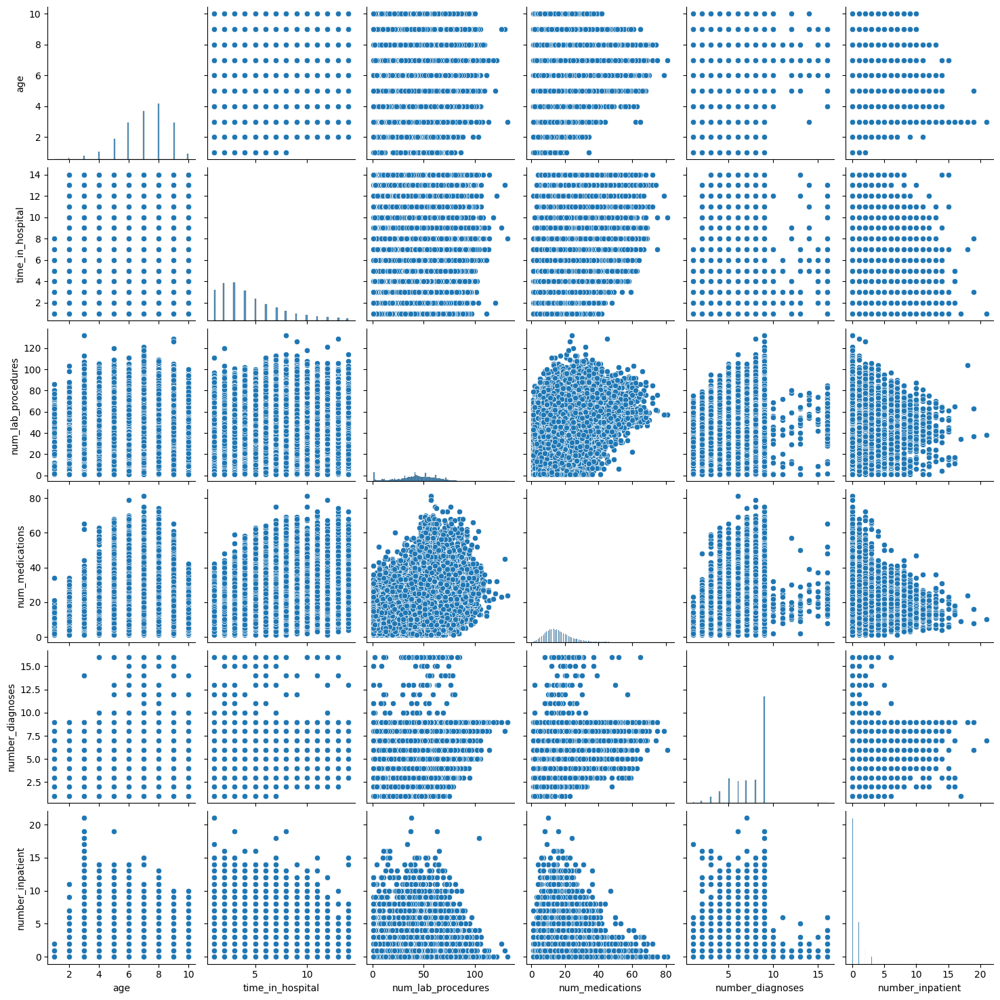

In [122]:
import seaborn as sns
import pandas as pd

# Assuming your data is stored in a DataFrame called df
data = diabetes[['age', 'time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient']]
sns.pairplot(data)

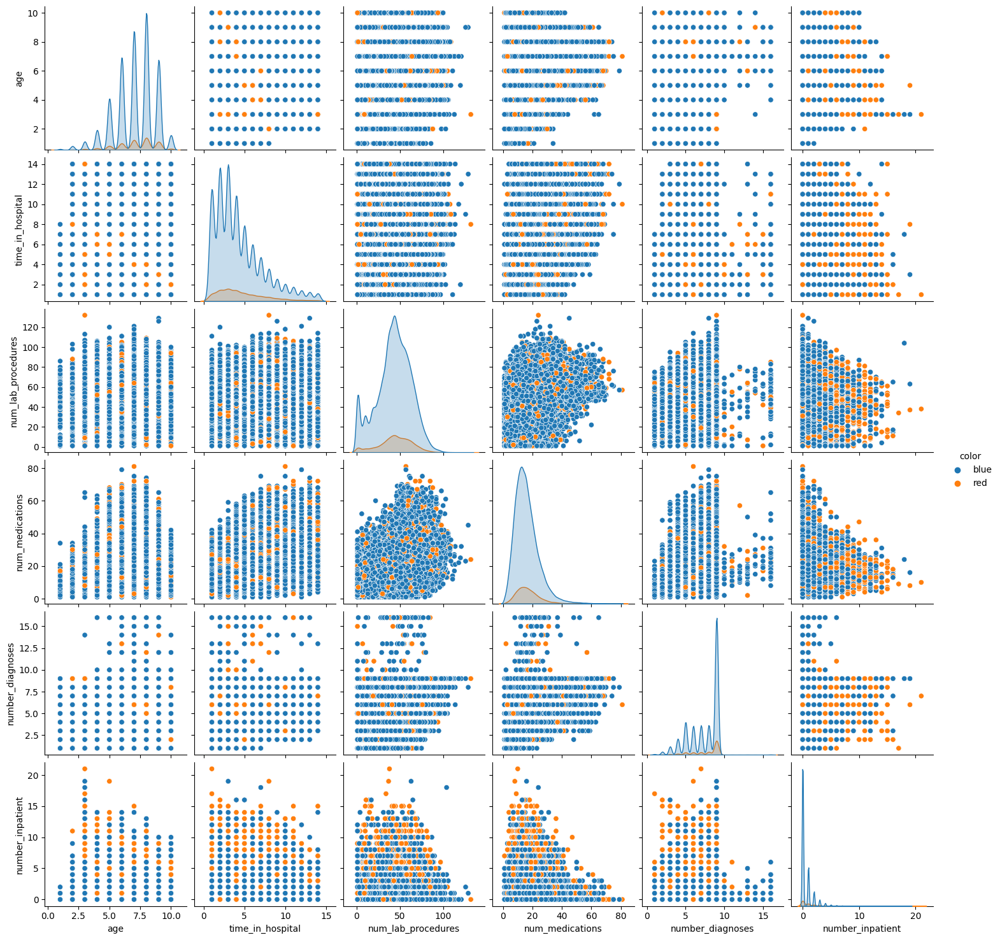

In [123]:
# Map readmitted values to colors
colors = {1: 'blue', 2: 'red'}
diabetes['color'] = diabetes['readmitted'].map(colors)

# Create pair plot with color mapping
sns.pairplot(data=diabetes, vars=['age', 'time_in_hospital', 'num_lab_procedures', 'num_medications', 'number_diagnoses', 'number_inpatient'], hue='color')
